## Combining Leiden/Louvain clustering with semi supervised training

Basically we do the following:

* initially use arbitrary method for dimensionality reduction of the data set (AE, PCA, etc.).
* run Leiden or Louvain clustering on the embeding
* semi supervise train gmmvae model on the data set, using the cluster assignment as out labels
  on a subset of the data, leaving most of it unlabeled.
* Then run Louvain or Leiden on the new embeding. If successful, some of the old clusters will be
  merged and we'll get fewer clusters and an organisation that more closely represents the true classes.
 
We start with MNIST, then test on RNA data.

In [1]:
#import gdown
import matplotlib.pyplot as plt
import numpy as np
#import os
import pandas as pd
import pyro
import pyro.distributions as pyrodist
import scanpy as sc
import seaborn as sns
#import time
import torch
import torch.utils.data
import torchvision.utils as vutils
import umap
from abc import abstractmethod
from anndata.experimental.pytorch import AnnLoader
from importlib import reload
from math import pi, sin, cos, sqrt, log
from pyro.infer import SVI, JitTrace_ELBO, Trace_ELBO, TraceGraph_ELBO
from pyro.optim import Adam
import sklearn
from sklearn import datasets as skds
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import normalized_mutual_info_score
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn import mixture
from toolz import partial, curry
from torch import nn, optim, distributions, Tensor
from torch.nn.functional import one_hot
from torchvision import datasets, transforms, models
from torchvision.utils import save_image, make_grid
from typing import Callable, Iterator, Union, Optional, TypeVar
from typing import List, Set, Dict, Tuple
from typing import Mapping, MutableMapping, Sequence, Iterable
from typing import Union, Any, cast, IO, TextIO
from torch.utils.data import WeightedRandomSampler
# my own sauce
from my_torch_utils import denorm, normalize, mixedGaussianCircular
from my_torch_utils import fclayer, init_weights, buildNetwork
from my_torch_utils import fnorm, replicate, logNorm, log_gaussian_prob
from my_torch_utils import plot_images, save_reconstructs, save_random_reconstructs
from my_torch_utils import scsimDataset
import my_torch_utils as ut
from importlib import reload
from torch.nn import functional as F
import gmmvae03 as M3
import gmmvae04 as M4
import gmmvae05 as M5
import gmmvae06 as M6
import gmmvae07 as M7
import gmmvae08 as M8
import gmmvae09 as M9
print(torch.cuda.is_available())


sc.settings.verbosity = 3
sc.logging.print_header()
sc.settings.set_figure_params(dpi=120, facecolor='white', )

enc = OneHotEncoder(sparse=False, dtype=np.float32)
enc_ct = LabelEncoder()


True
True
True
True
True
True
True
True
scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.22.1 scipy==1.7.3 pandas==1.4.0 scikit-learn==1.0.2 statsmodels==0.13.1 python-igraph==0.9.9 louvain==0.7.1 pynndescent==0.5.6


In [2]:
transform = transforms.Compose([
    transforms.ToTensor(),
    ])
test_loader = torch.utils.data.DataLoader(
   dataset=datasets.MNIST(
       root='data/',
       train=False,
       download=True,
       transform=transform,
       ),
   batch_size=128,
   shuffle=True,
)
train_loader = torch.utils.data.DataLoader(
   dataset=datasets.MNIST(
       root='data/',
       train=True,
       download=True,
       transform=transform,
       ),
   batch_size=128,
   shuffle=True,
)
test_data = test_loader.dataset.data.float()/255
test_labels = F.one_hot(test_loader.dataset.targets.long(),
        num_classes=10,).float()
train_data = train_loader.dataset.data.float()/255
train_labels = F.one_hot(
        train_loader.dataset.targets.long(),
        num_classes=10,).float()


dataset = ut.SynteticDataSet(
        train_data, train_labels,)
data_loader = torch.utils.data.DataLoader(
        dataset=dataset,
        batch_size=128,
        shuffle=True,
        )

labeled_set = ut.SynteticDataSet(
        train_data[:2000], train_labels[:2000],)
labeled_loader = torch.utils.data.DataLoader(
        dataset=labeled_set,
        shuffle=True,
        batch_size=128,
        )
unlabeled_set = ut.SynteticDataSet(
        train_data[2000:], train_labels[2000:],)
unlabeled_loader = torch.utils.data.DataLoader(
        dataset=unlabeled_set,
        shuffle=True,
        batch_size=128,
        )
test_set = ut.SynteticDataSet(
        test_data, test_labels,)
testloader = torch.utils.data.DataLoader(
        dataset=test_set,
        shuffle=True,
        batch_size=128,
        )

adata = sc.AnnData(X=train_data.detach().flatten(1).numpy(), )
adata.obs["labels"] = train_loader.dataset.targets.numpy().astype(str)


In [3]:
enc_ct.fit(adata.obs["labels"])
data = torch.FloatTensor(adata.X)


computing PCA
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:07)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 12 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:12)


/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'labels' as categorical


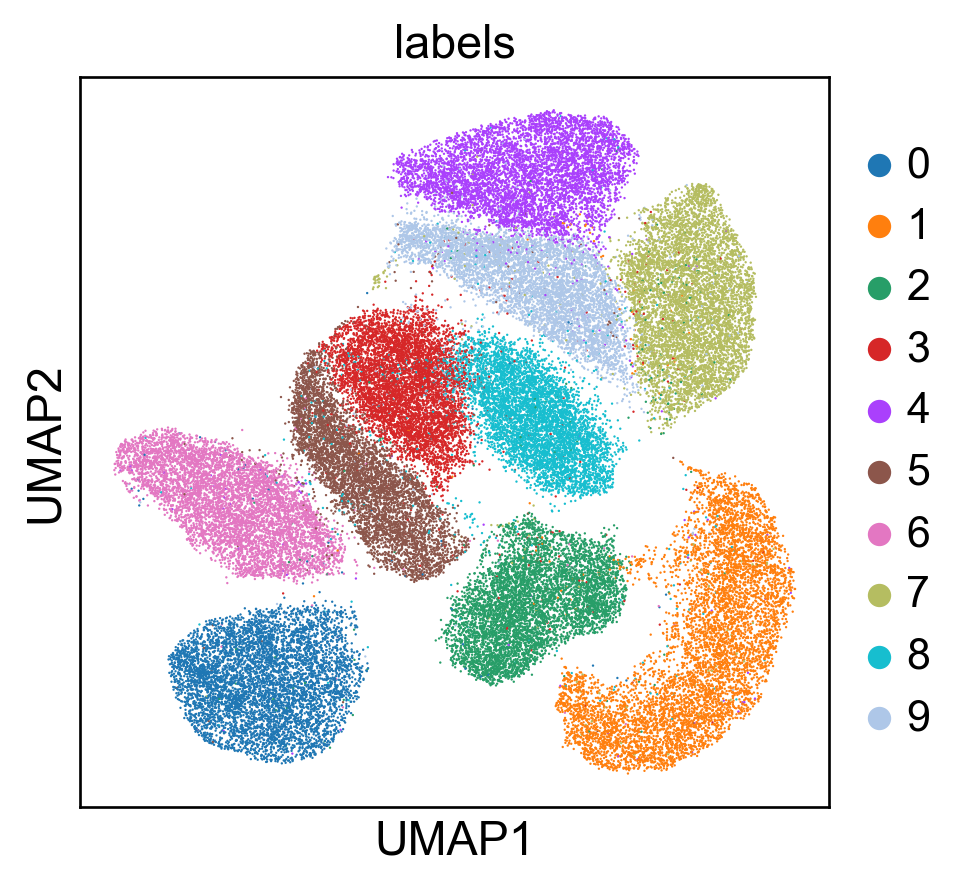

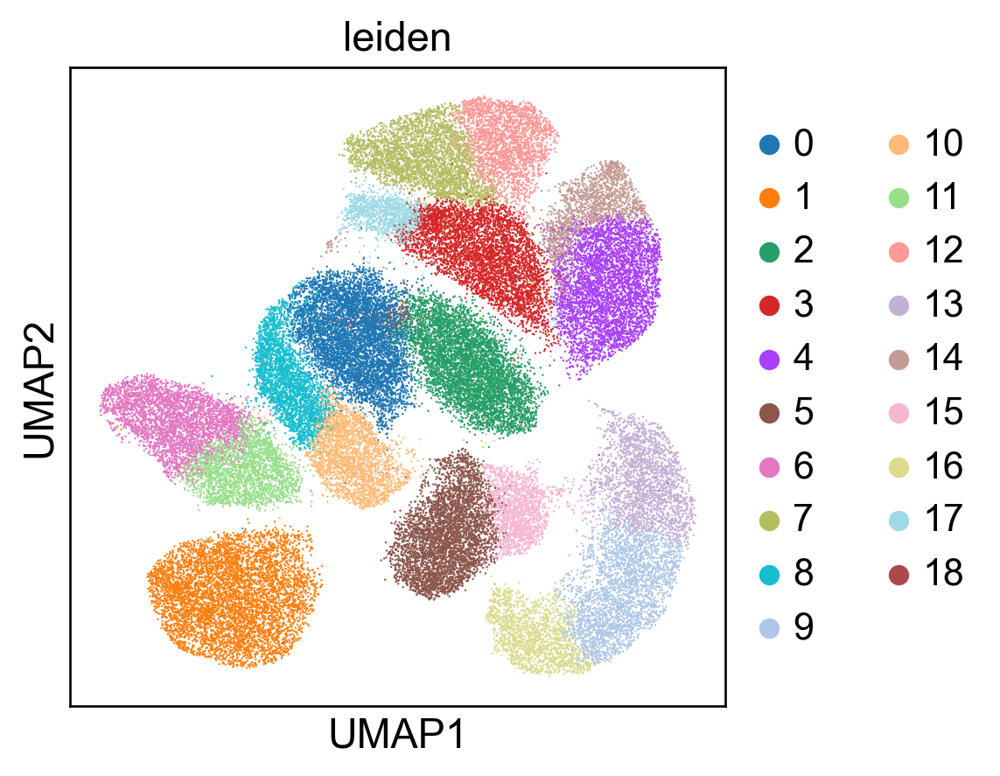

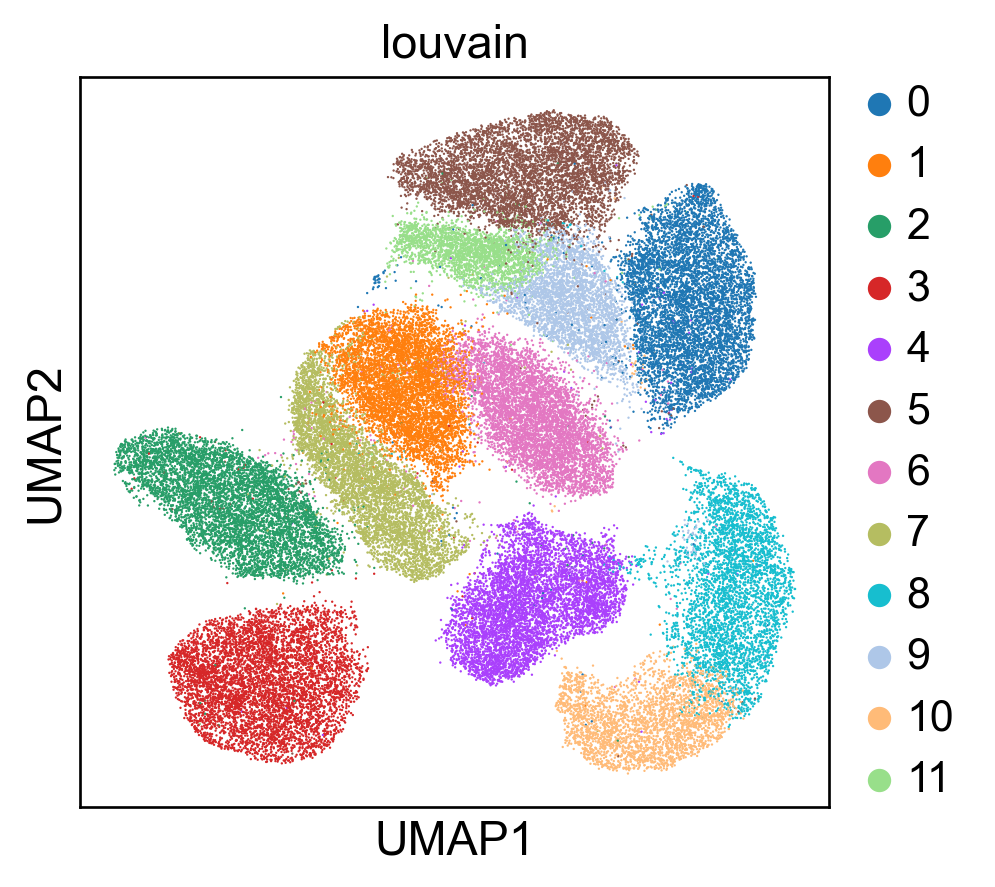

In [4]:
sc.pp.pca(adata,)
sc.pp.neighbors(adata, use_rep="X_pca", n_neighbors=10,)
sc.tl.umap(adata,)
#sc.tl.tsne(adata, )
sc.tl.leiden(adata, )
sc.tl.louvain(adata, )
sc.pl.umap(adata, color=["labels",],)
sc.pl.umap(adata, color=["leiden",],)
sc.pl.umap(adata, color=["louvain"],)
#sc.pl.tsne(adata, color=["labels", "leiden", "louvain"],)

In [37]:
model = M8.VAE_Dirichlet_Type807(
        nx=adata.n_vars, nh=1024,
        nz=50, nw=15,
        dirscale=1e0,
        concentration=1e-1,
        nclasses=14,
        )
model = M8.VAE_Dirichlet_Type805(
        nx=adata.n_vars, nh=1024,
        nz=50, nw=15,
        dirscale=1e0,
        concentration=1e-1,
        nclasses=14,
        )
model = M8.VAE_Dirichlet_Type807(
        nx=adata.n_vars, nh=3024,
        nz=28, nw=9,
        dirscale=1e0,
        concentration=5e-1,
        nclasses=16,
        )

model = M7.VAE_Stacked_Dilo_Anndata_Type701(
        nx=adata.n_vars, nh=1024,
        nz=50, nw=19,
        nclasses=16,
        )

model = M6.VAE_Dirichlet_Type05(
        nx=adata.n_vars, nh=1024,
        nz=50, nw=19,
        nclasses=16,
)

model = M6.VAE_Dilo_Type601(nx=28**2,
                            nh=1200, nz=30, nw=25, nclasses=10,
                           )

# okish result
model = M3.VAE_Dilo3(nz=20, nw=25, nh=1024*2, nclasses=23)
#model.fit(train_loader, num_epochs=10)
# okish result
model = M7.VAE_Stacked_Dilo_Anndata_Type701(
        nx=adata.n_vars, nh=1024*2,
        nz=30, nw=25,
        nclasses=23,
        )
model = M8.VAE_Dirichlet_Type806(
        nx=adata.n_vars, nh=1024*2,
        nz=30, nw=25,
        dirscale=1e0,
        concentration=1e0,
        nclasses=23,
        )
model.apply(init_weights)

VAE_Dirichlet_Type806(
  (Px): Sequential(
    (linear1): Linear(in_features=30, out_features=2048, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=2048, out_features=2048, bias=True)
    (dropout2): Dropout(p=0.2, inplace=False)
    (batchnorm2): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation2): LeakyReLU(negative_slope=0.01)
    (output_layer): Linear(in_features=2048, out_features=784, bias=True)
  )
  (Pz): Sequential(
    (linear1): Linear(in_features=25, out_features=2048, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=2048, out_features=2048, bias=T

In [38]:
M8.basicTrain(model, data_loader, test_loader,
              num_epochs=10, wt=0e-3, lr=1e-3, report_interval=7)
M8.basicTrain(model, data_loader, test_loader,
              num_epochs=10, wt=0e-3, lr=1e-4, report_interval=7)

training phase
rec: 1048.0140380859375
loss_z: 31.968196868896484
loss_w: 12.92992115020752
loss_l: 0.06889770925045013
loss_l_alt: 0.35179242491722107
loss_y: -0.17060036957263947
loss_d: 23.248693466186523
loss_y_alt: 1.7157493829727173
loss_y_alt2: 0
num_clusters: 0
total_loss: 1117.87646484375

training phase
rec: -886.445068359375
loss_z: 22.385475158691406
loss_w: 5.5832438468933105
loss_l: 0.5600705146789551
loss_l_alt: 3.065392017364502
loss_y: -0.9709891080856323
loss_d: 0.285908967256546
loss_y_alt: 2.834599494934082
loss_y_alt2: 0
num_clusters: 16
total_loss: -855.3558349609375

training phase
rec: -1146.1025390625
loss_z: 25.1905517578125
loss_w: 7.015744209289551
loss_l: 0.4138522744178772
loss_l_alt: 3.0773773193359375
loss_y: -0.9759185314178467
loss_d: 0.35930025577545166
loss_y_alt: 2.8005428314208984
loss_y_alt2: 0
num_clusters: 16
total_loss: -1110.7364501953125

training phase
rec: -1251.236572265625
loss_z: 24.95886993408203
loss_w: 7.160008430480957
loss_l: 0.4166

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 17 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:09)
running Leiden clustering
    finished: found 20 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:10)


/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predict' as categorical


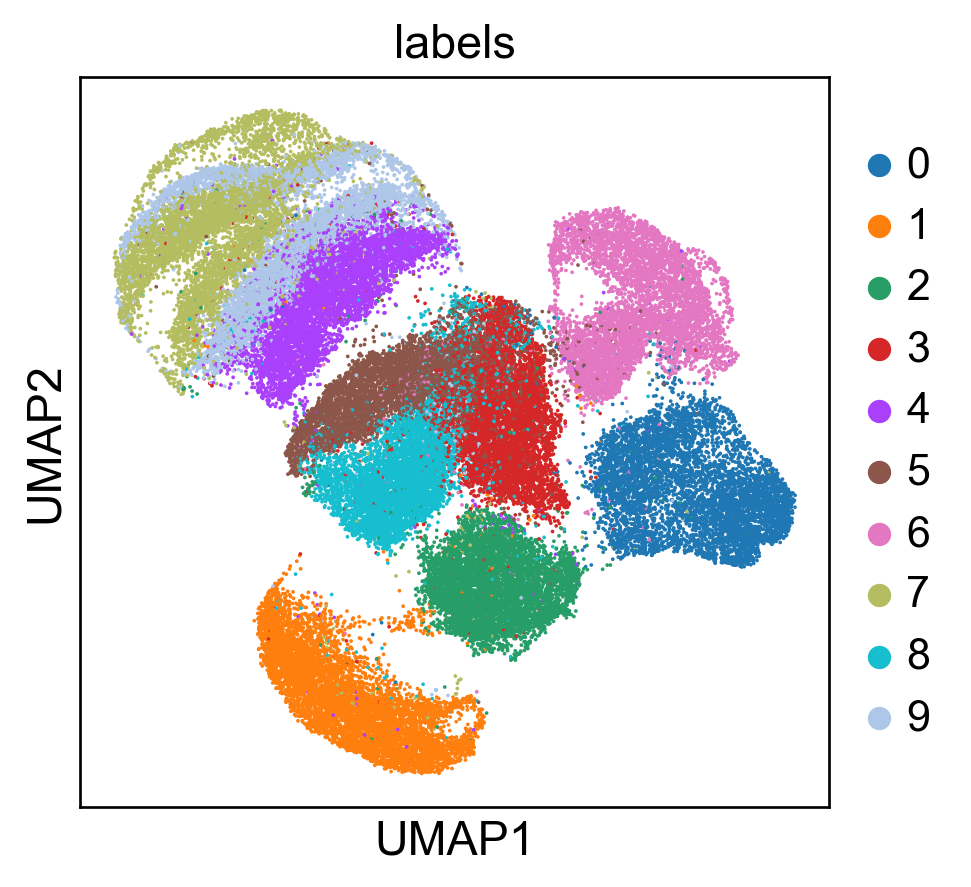

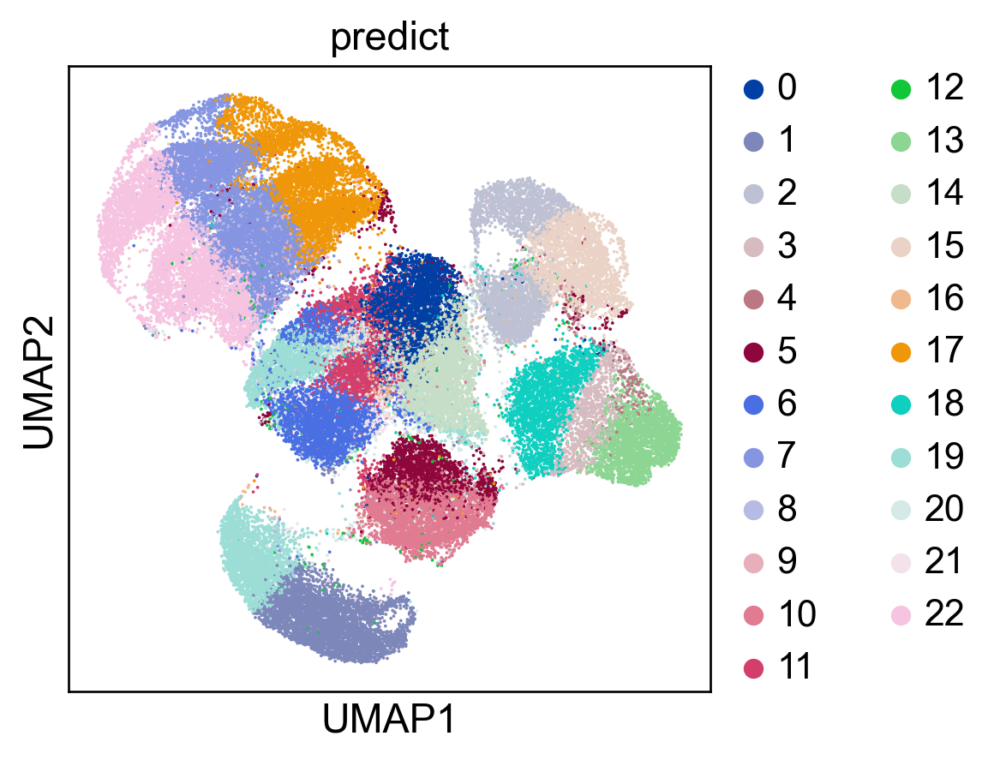

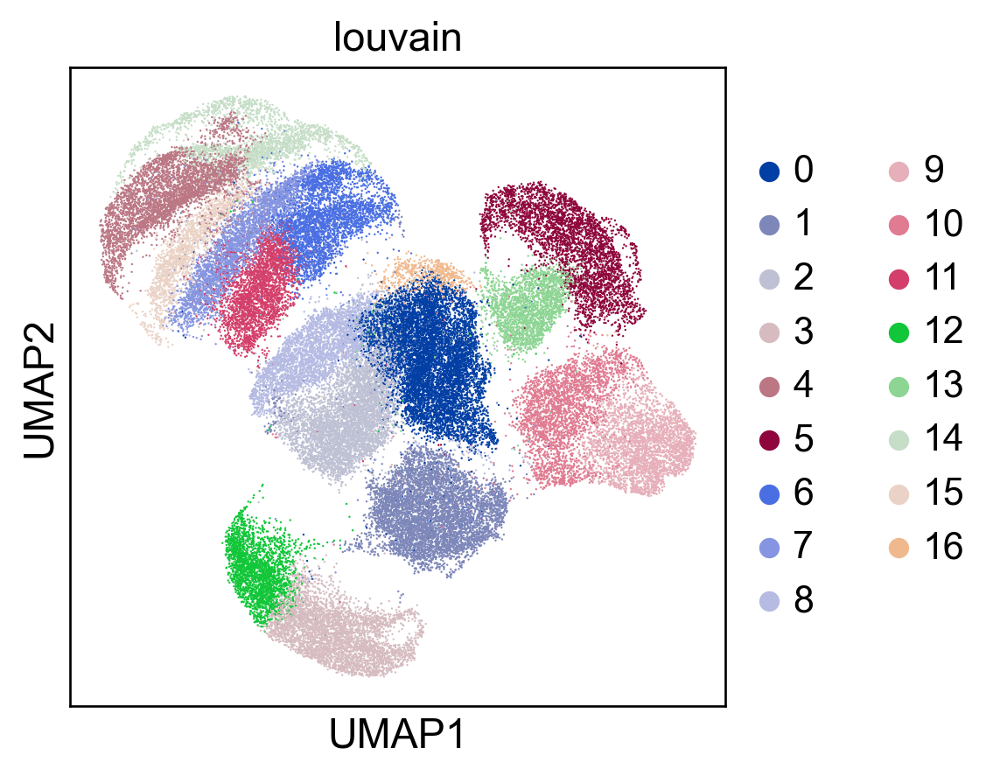

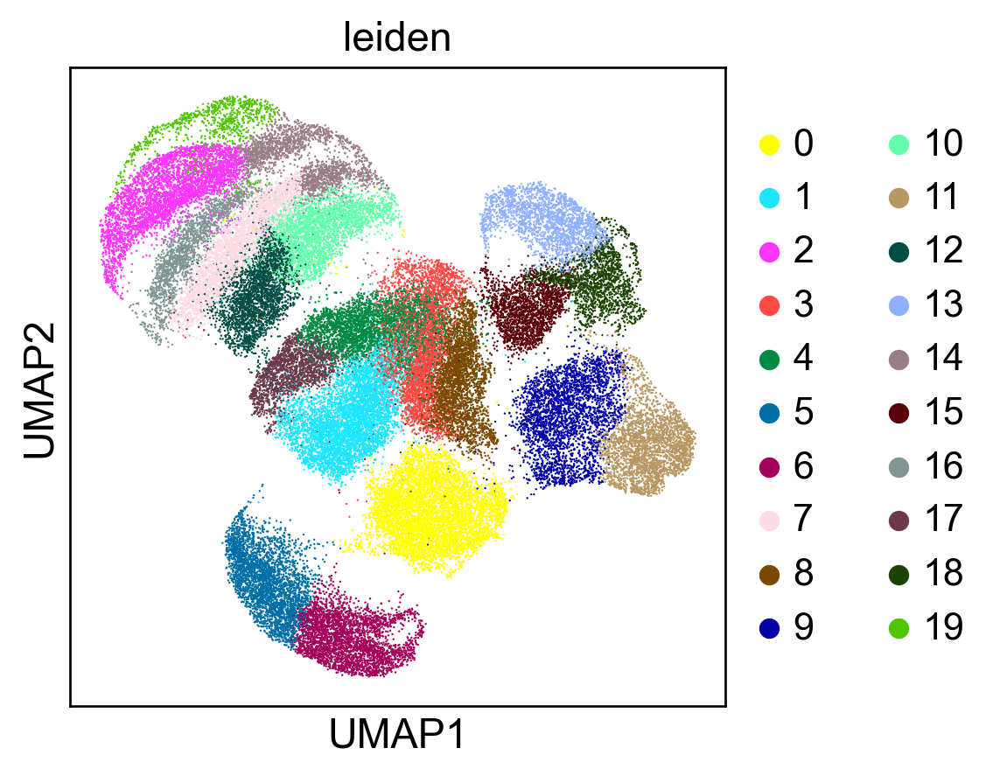

In [39]:
model.eval()
output = model(data)
adata.obsm["z"] = output["z"].detach().numpy()
adata.obs["predict"] = output["q_y"].detach().argmax(-1).numpy().astype(str)
#adata.obs["predict2"] = output["d_logits"].detach().argmax(-1).numpy().astype(str)
sc.pp.neighbors(adata, use_rep="z", n_neighbors=10,)
sc.tl.umap(adata,)
sc.tl.louvain(adata, )
sc.tl.leiden(adata, )
sc.pl.umap(adata, color=["labels"], size=5)
sc.pl.umap(adata, color=["predict", ],size=5)
#sc.pl.umap(adata, color=["predict2", ],size=5)
sc.pl.umap(adata, color=["louvain", ],)
sc.pl.umap(adata, color=["leiden"],)
del output

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


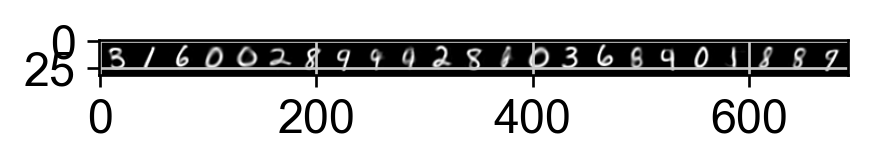

In [40]:
model.eval()
w = torch.zeros(1, model.nw)
z = model.Pz(w)
mu = z[:,:,:model.nz].reshape(1*model.nclasses, model.nz)
rec = model.Px(mu).reshape(-1,1,28,28)
ut.plot_images(rec, model.nclasses)



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


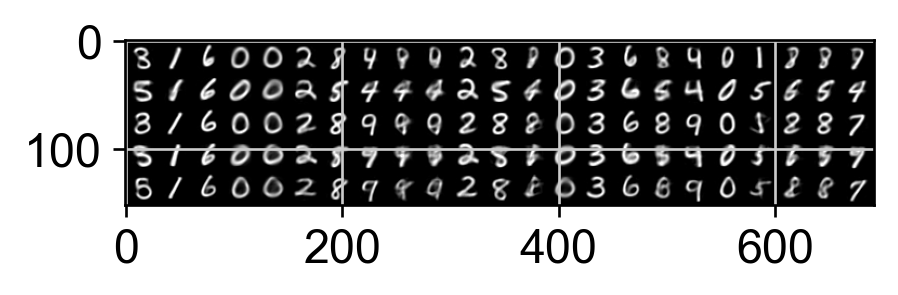

In [41]:
w = model.w_prior.sample((5, ))
z = model.Pz(w)
mu = z[:,:,:model.nz].reshape(5*model.nclasses, model.nz)
rec = model.Px(mu).reshape(-1,1,28,28)
ut.plot_images(rec, model.nclasses)


In [42]:
model

VAE_Dirichlet_Type806(
  (Px): Sequential(
    (linear1): Linear(in_features=30, out_features=2048, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=2048, out_features=2048, bias=True)
    (dropout2): Dropout(p=0.2, inplace=False)
    (batchnorm2): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation2): LeakyReLU(negative_slope=0.01)
    (output_layer): Linear(in_features=2048, out_features=784, bias=True)
  )
  (Pz): Sequential(
    (linear1): Linear(in_features=25, out_features=2048, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=2048, out_features=2048, bias=T

In [59]:
model = M8.AE_Primer_Type801(
    nx=28**2, nh=1024, nz=30,
    bn=True, dropout=0.2,
)
model = M8.AE_Primer_Type801(
    nx=28**2, nh=1024, nz=64,
    bn=True, dropout=0.2,
)
model.apply(init_weights)
M8.basicTrain(model, data_loader, test_loader,
              num_epochs=10, wt=0e-3, lr=1e-3, report_interval=7)
M8.basicTrain(model, data_loader, test_loader,
              num_epochs=10, wt=0e-3, lr=1e-4, report_interval=7)

training phase
rec: 989.748779296875
total_loss: 989.748779296875

training phase
rec: -978.8822021484375
total_loss: -978.8822021484375

training phase
rec: -1279.655029296875
total_loss: -1279.655029296875

training phase
rec: -1245.947265625
total_loss: -1245.947265625



computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 18 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:10)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:10)


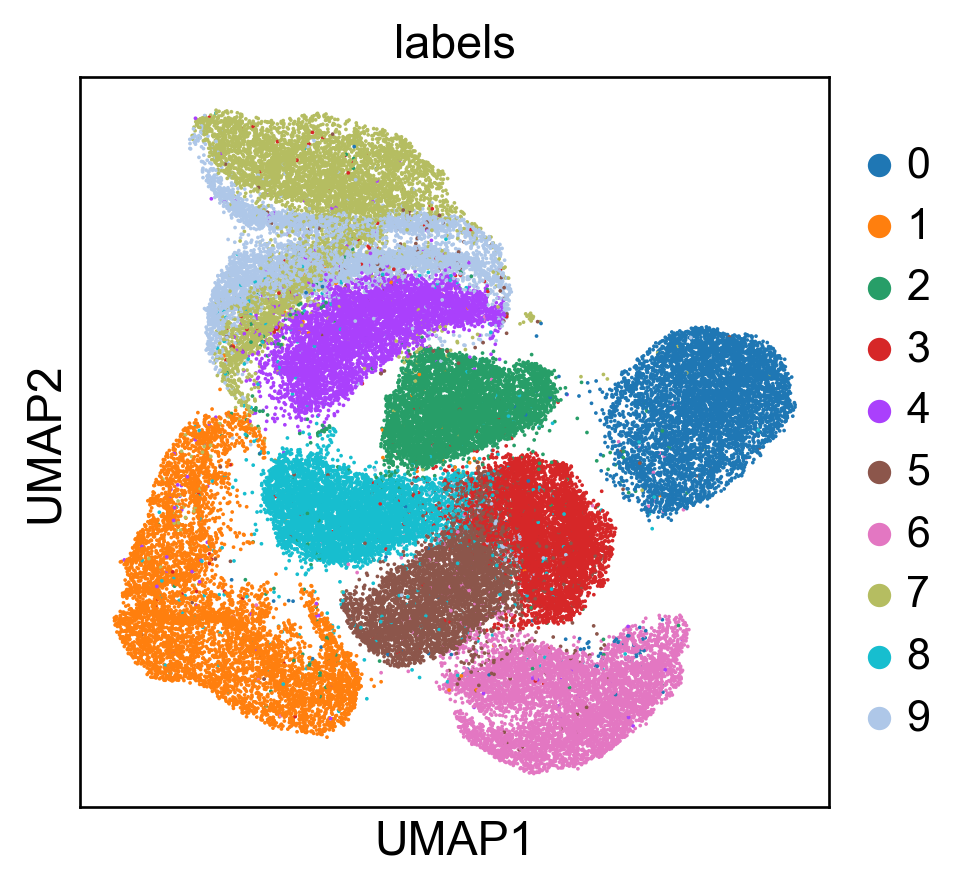

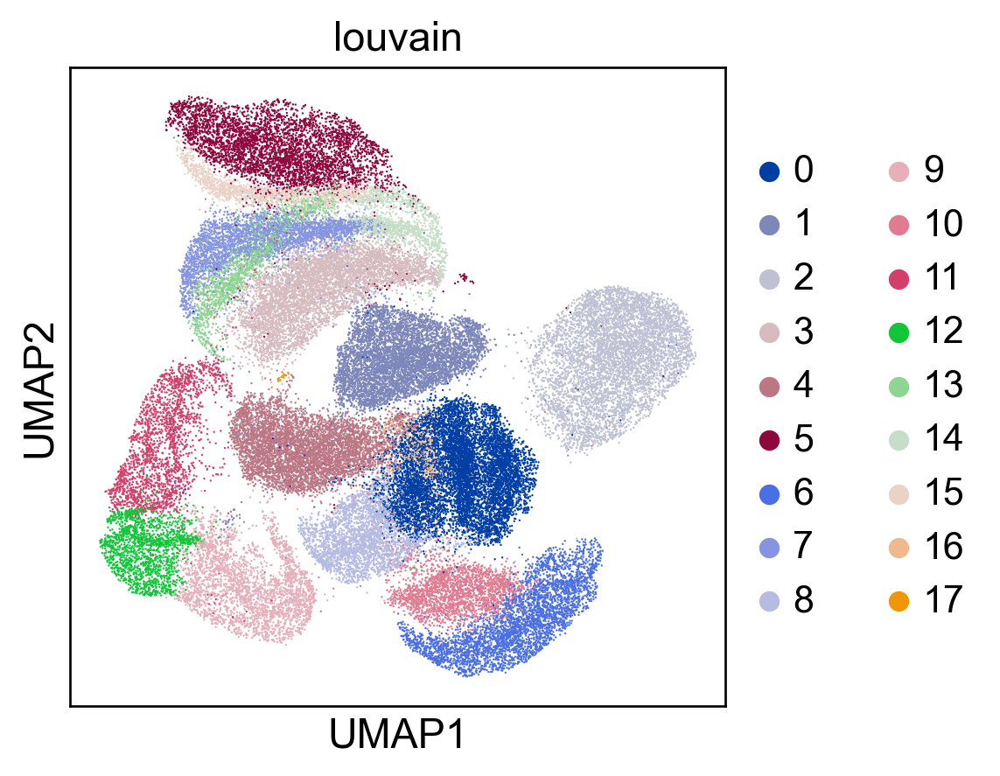

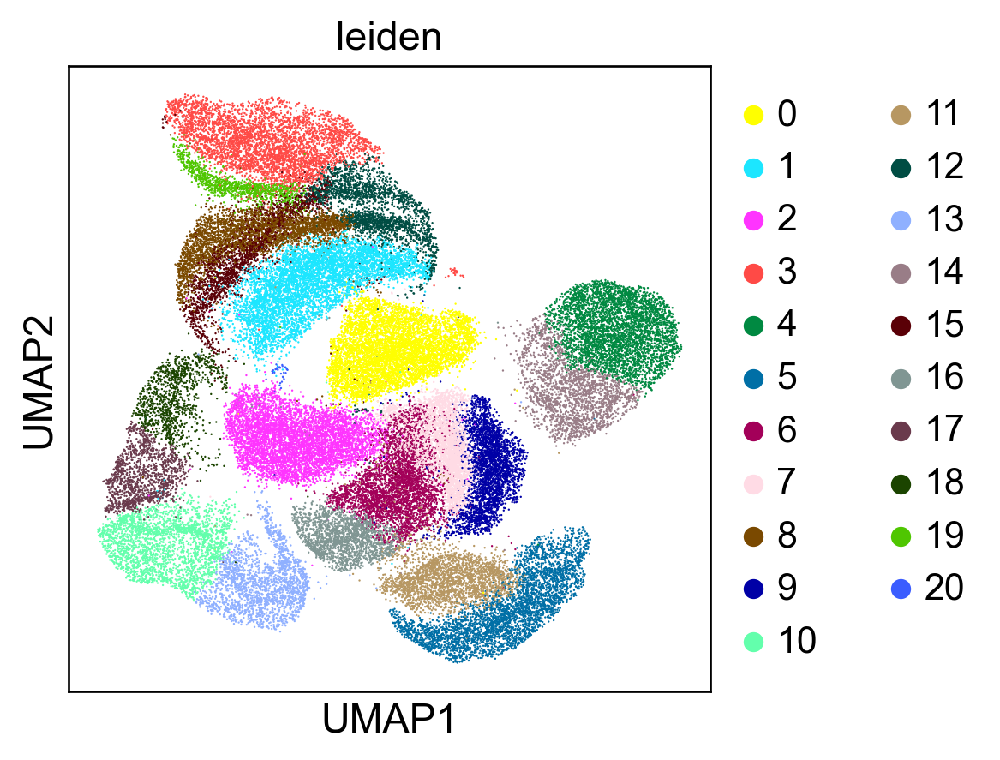

In [60]:
model.eval()
output = model(data)
adata.obsm["z"] = output["z"].detach().numpy()
#adata.obs["predict"] = output["q_y"].detach().argmax(-1).numpy().astype(str)
#adata.obs["predict2"] = output["d_logits"].detach().argmax(-1).numpy().astype(str)
sc.pp.neighbors(adata, use_rep="z", n_neighbors=10,)
sc.tl.umap(adata,)
sc.tl.louvain(adata, )
sc.tl.leiden(adata, )
sc.pl.umap(adata, color=["labels"], size=5)
#sc.pl.umap(adata, color=["predict", ],size=5)
#sc.pl.umap(adata, color=["predict2", ],size=5)
sc.pl.umap(adata, color=["louvain", ],)
sc.pl.umap(adata, color=["leiden"],)
del output


In [61]:
new_train_labels = F.one_hot(
        torch.tensor(
            adata.obs["leiden"].to_numpy().astype('long')
            ),
        num_classes=adata.obs["leiden"].cat.categories.size,).float()
new_train_labels = F.one_hot(
        torch.tensor(
            adata.obs["louvain"].to_numpy().astype('long')
            ),
        num_classes=adata.obs["louvain"].cat.categories.size,).float()

labeled_set = ut.SynteticDataSet(
        train_data[:2000], new_train_labels[:2000],)
labeled_loader = torch.utils.data.DataLoader(
        dataset=labeled_set,
        shuffle=True,
        batch_size=128,
        )
unlabeled_set = ut.SynteticDataSet(
        train_data[2000:], new_train_labels[2000:],)
unlabeled_loader = torch.utils.data.DataLoader(
        dataset=unlabeled_set,
        shuffle=True,
        batch_size=128,
        )



In [62]:
model2 = M8.VAE_Dirichlet_Type807(
        nx=adata.n_vars, nh=1024,
        nz=28, nw=9,
        dirscale=1e0,
        concentration=5e-1,
        nclasses=adata.obs["leiden"].cat.categories.size,
        )
model2 = M8.VAE_Dirichlet_Type807(
        nx=adata.n_vars, nh=1024,
        nz=64, nw=40,
        dirscale=1e0,
        concentration=5e-1,
        nclasses=adata.obs["louvain"].cat.categories.size,
        )
model2.apply(init_weights)


VAE_Dirichlet_Type807(
  (Px): Sequential(
    (linear1): Linear(in_features=64, out_features=1024, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=1024, out_features=1024, bias=True)
    (dropout2): Dropout(p=0.2, inplace=False)
    (batchnorm2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation2): LeakyReLU(negative_slope=0.01)
    (output_layer): Linear(in_features=1024, out_features=784, bias=True)
  )
  (Pz): Sequential(
    (linear1): Linear(in_features=40, out_features=1024, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=1024, out_features=1024, bias=T

In [64]:
M8.trainSemiSuper(model2, labeled_loader, unlabeled_loader, test_loader, 
        num_epochs=63, lr=1e-3, wt=0, do_unlabeled=True, do_eval=False, report_interval=5,)
M8.trainSemiSuper(model2, labeled_loader, unlabeled_loader, test_loader, 
        num_epochs=63, lr=3e-4, wt=0, do_unlabeled=True, do_eval=False, report_interval=5,)

#model2.nclasses

labeled phase
rec: -529.2250366210938
loss_z: 19.687652587890625
loss_w: 3.813598155975342
loss_l: 0.2528100311756134
loss_l_alt: 2.711937427520752
loss_y: -0.9326807856559753
loss_d: 0.6130166053771973
loss_y_alt: 2.6575770378112793
loss_y_alt2: 0.2991705536842346
total_loss: -502.154052734375
num_clusters: 18

unlabeled phase
rec: -516.6199951171875
loss_z: 21.760513305664062
loss_w: 3.956881284713745
loss_l: 0.2812283933162689
loss_l_alt: 2.677194356918335
loss_y: -0.9214166402816772
loss_d: 0.5716211795806885
loss_y_alt: 2.525505304336548
loss_y_alt2: 0
total_loss: -487.80548095703125
num_clusters: 17

labeled phase
rec: -596.9954223632812
loss_z: 21.091629028320312
loss_w: 3.998969078063965
loss_l: 0.24330733716487885
loss_l_alt: 2.763737678527832
loss_y: -0.9552741050720215
loss_d: 0.618794858455658
loss_y_alt: 2.441181182861328
loss_y_alt2: 0.3095932602882385
total_loss: -568.5353393554688
num_clusters: 16

unlabeled phase
rec: -580.7281494140625
loss_z: 22.106468200683594
loss_

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:26)


/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predict' as categorical
/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predict2' as categorical


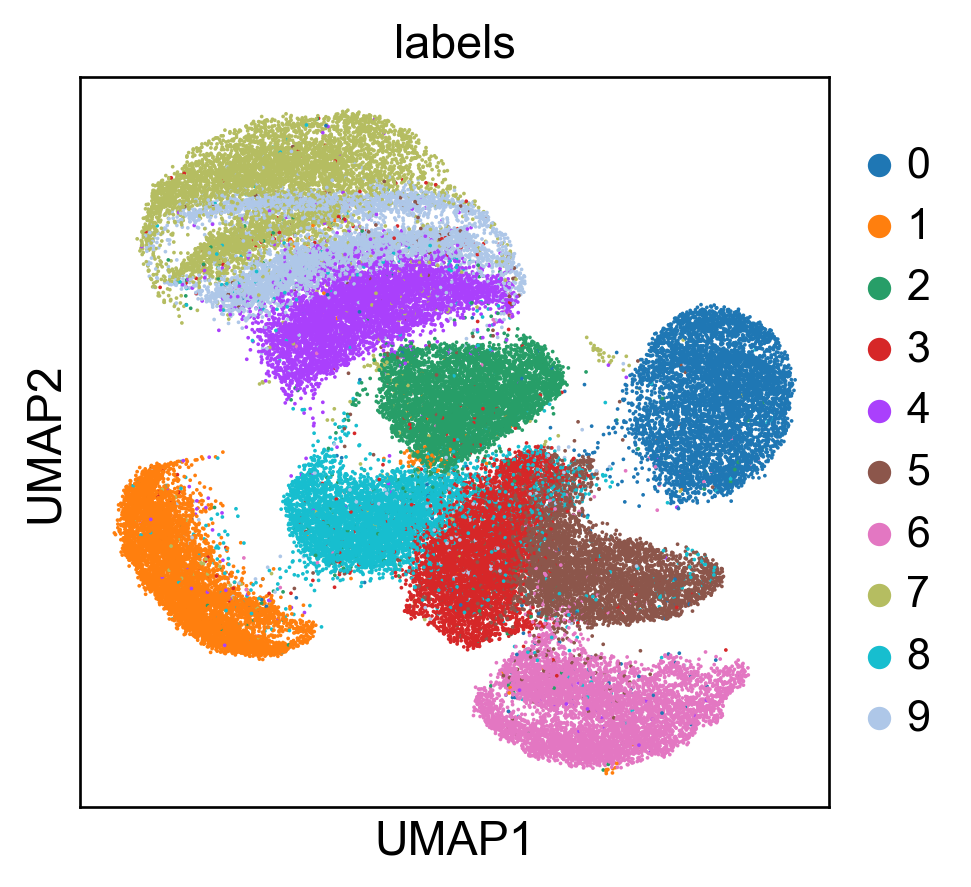

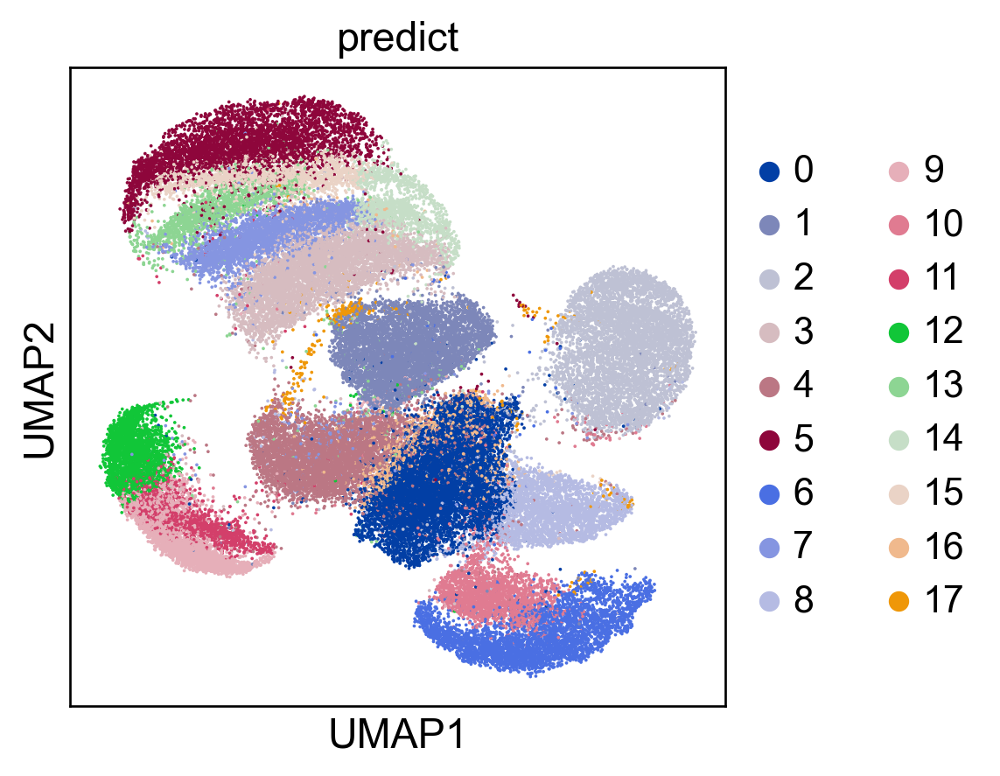

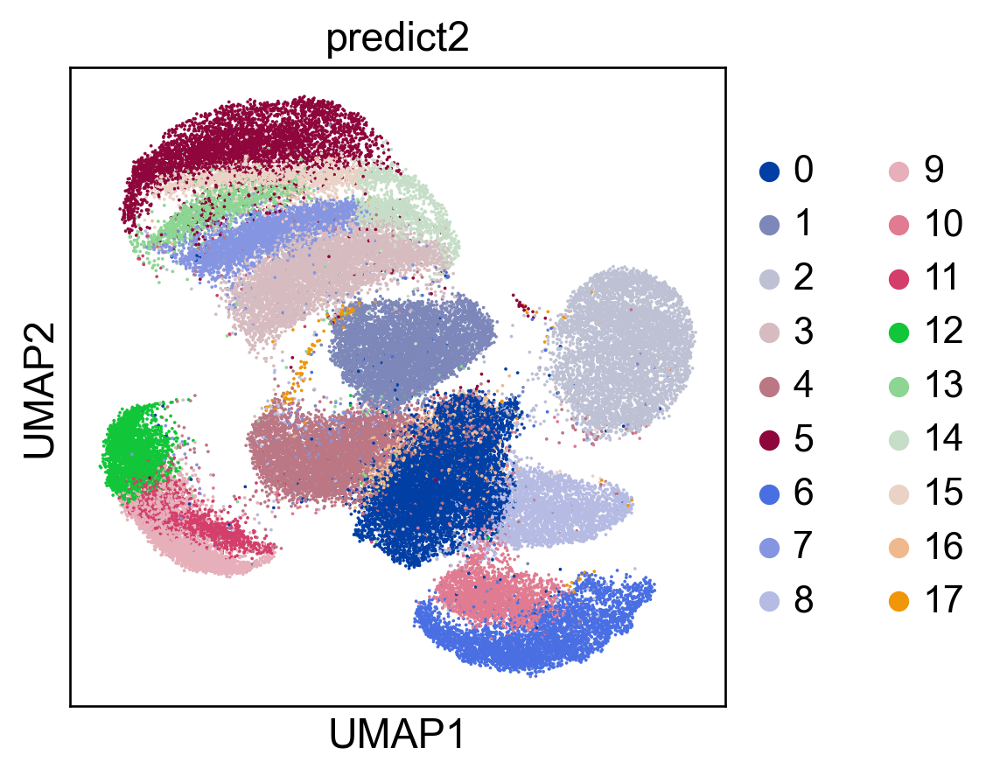

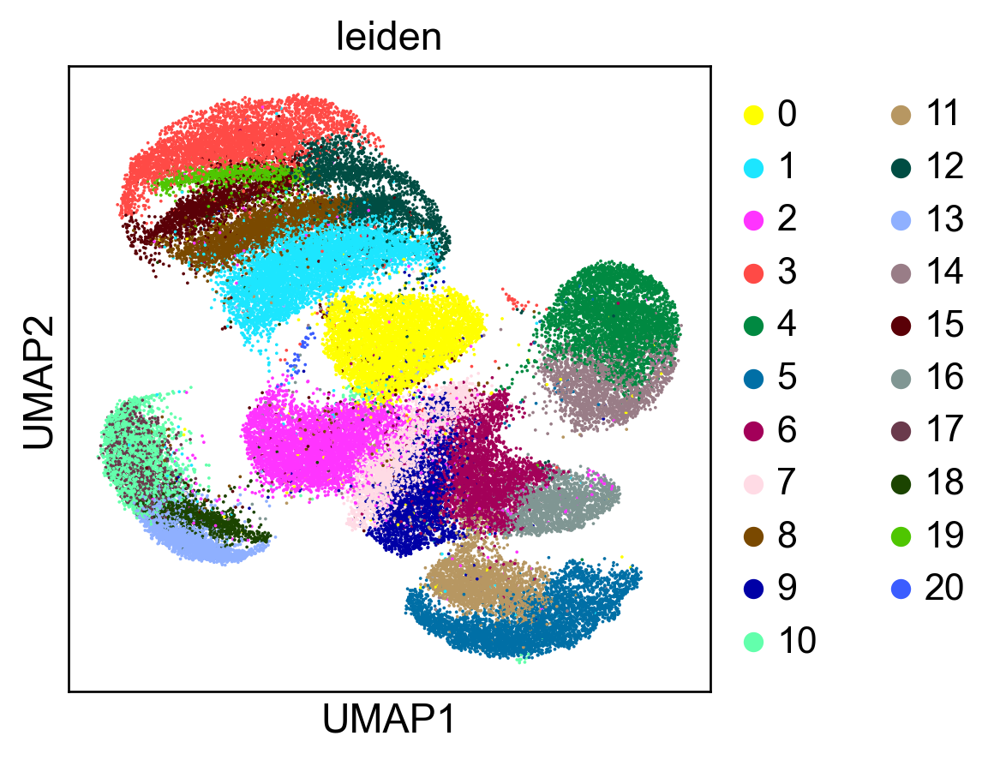

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:07)


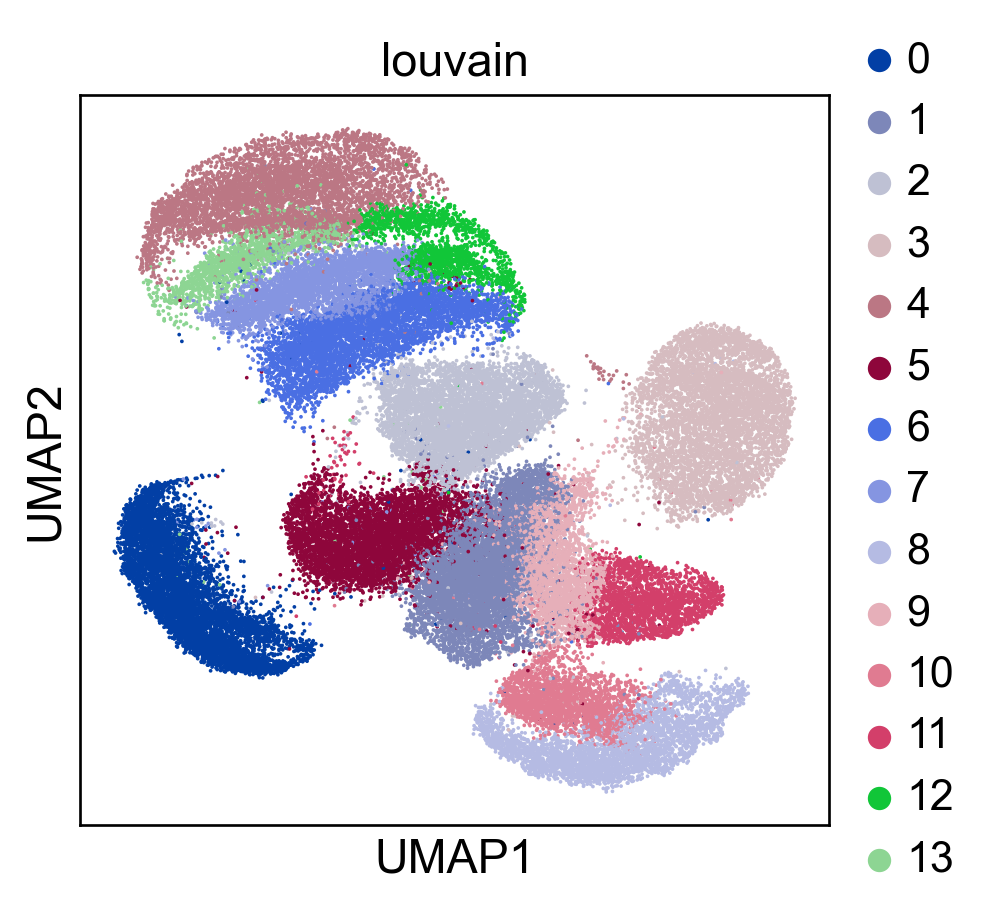

In [65]:

model2.eval()
output = model2(data)
adata.obsm["z"] = output["z"].detach().numpy()
adata.obs["predict"] = output["q_y"].detach().argmax(-1).numpy().astype(str)
adata.obs["predict2"] = output["d_logits"].detach().argmax(-1).numpy().astype(str)
sc.pp.neighbors(adata, use_rep="z", n_neighbors=10,)
sc.tl.umap(adata,)

sc.pl.umap(adata, color=["labels"], size=5)
sc.pl.umap(adata, color=["predict", ],size=5)
sc.pl.umap(adata, color=["predict2", ],size=5)

sc.pl.umap(adata, color=["leiden", ],size=5)

sc.tl.louvain(adata, copy=False)

sc.pl.umap(adata, color=["louvain", ],size=5)

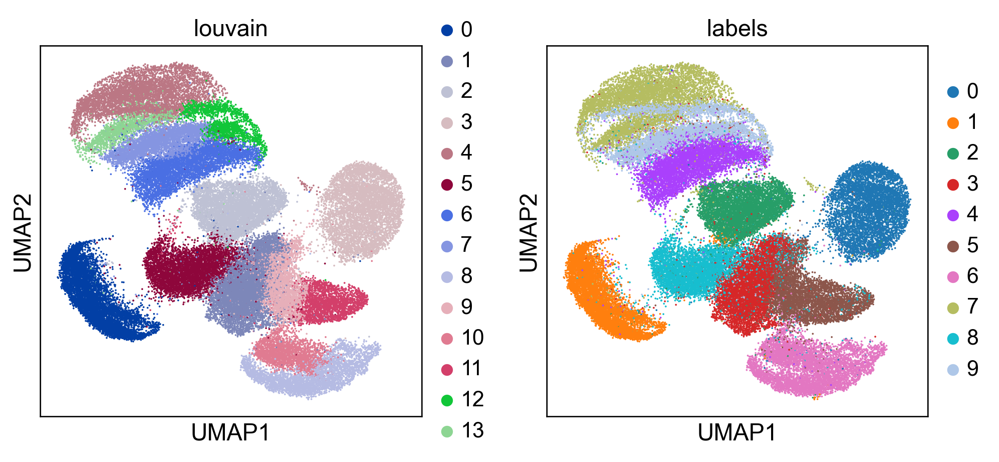

In [66]:
sc.pl.umap(adata, color=["louvain", "labels",],size=5)


In [67]:
new_train_labels = F.one_hot(
        torch.tensor(
            adata.obs["louvain"].to_numpy().astype('long')
            ),
        num_classes=adata.obs["louvain"].cat.categories.size,).float()

labeled_set = ut.SynteticDataSet(
        train_data[:2000], new_train_labels[:2000],)
labeled_loader = torch.utils.data.DataLoader(
        dataset=labeled_set,
        shuffle=True,
        batch_size=128,
        )
unlabeled_set = ut.SynteticDataSet(
        train_data[2000:], new_train_labels[2000:],)
unlabeled_loader = torch.utils.data.DataLoader(
        dataset=unlabeled_set,
        shuffle=True,
        batch_size=128,
        )


In [68]:
model3 = M8.VAE_Dirichlet_Type807(
        nx=adata.n_vars, nh=1024,
        nz=64, nw=40,
        dirscale=1e0,
        concentration=5e-1,
        nclasses=adata.obs["louvain"].cat.categories.size,
        )
model3.apply(init_weights)


VAE_Dirichlet_Type807(
  (Px): Sequential(
    (linear1): Linear(in_features=64, out_features=1024, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=1024, out_features=1024, bias=True)
    (dropout2): Dropout(p=0.2, inplace=False)
    (batchnorm2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation2): LeakyReLU(negative_slope=0.01)
    (output_layer): Linear(in_features=1024, out_features=784, bias=True)
  )
  (Pz): Sequential(
    (linear1): Linear(in_features=40, out_features=1024, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=1024, out_features=1024, bias=T

In [69]:
M8.trainSemiSuper(model3, labeled_loader, unlabeled_loader, test_loader, 
        num_epochs=63, lr=1e-3, wt=0, do_unlabeled=True, do_eval=False, report_interval=5,)
M8.trainSemiSuper(model3, labeled_loader, unlabeled_loader, test_loader, 
        num_epochs=63, lr=3e-4, wt=0, do_unlabeled=True, do_eval=False, report_interval=5,)



labeled phase
rec: 981.6461181640625
loss_z: 52.56572723388672
loss_w: 21.42923355102539
loss_l: 0.1648842990398407
loss_l_alt: 0.45552170276641846
loss_y: -0.28711479902267456
loss_d: 7.397244453430176
loss_y_alt: 3.8299436569213867
loss_y_alt2: 3.1434197425842285
total_loss: 1070.0115966796875
num_clusters: 2

unlabeled phase
rec: 805.6019897460938
loss_z: 12.515752792358398
loss_w: 8.050130844116211
loss_l: 0.13147754967212677
loss_l_alt: 1.1991944313049316
loss_y: -0.5320590734481812
loss_d: 3.769380569458008
loss_y_alt: 1.8309632539749146
loss_y_alt2: 0
total_loss: 831.7682495117188
num_clusters: 10

labeled phase
rec: 615.7102661132812
loss_z: 5.718621253967285
loss_w: 2.3533265590667725
loss_l: 0.15074311196804047
loss_l_alt: 1.897817850112915
loss_y: -0.7316839694976807
loss_d: 0.977741003036499
loss_y_alt: 2.9135854244232178
loss_y_alt2: 1.2144138813018799
total_loss: 628.887939453125
num_clusters: 11

unlabeled phase
rec: 604.6484375
loss_z: 6.60654354095459
loss_w: 2.4586684

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:26)


/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predict' as categorical
/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predict2' as categorical


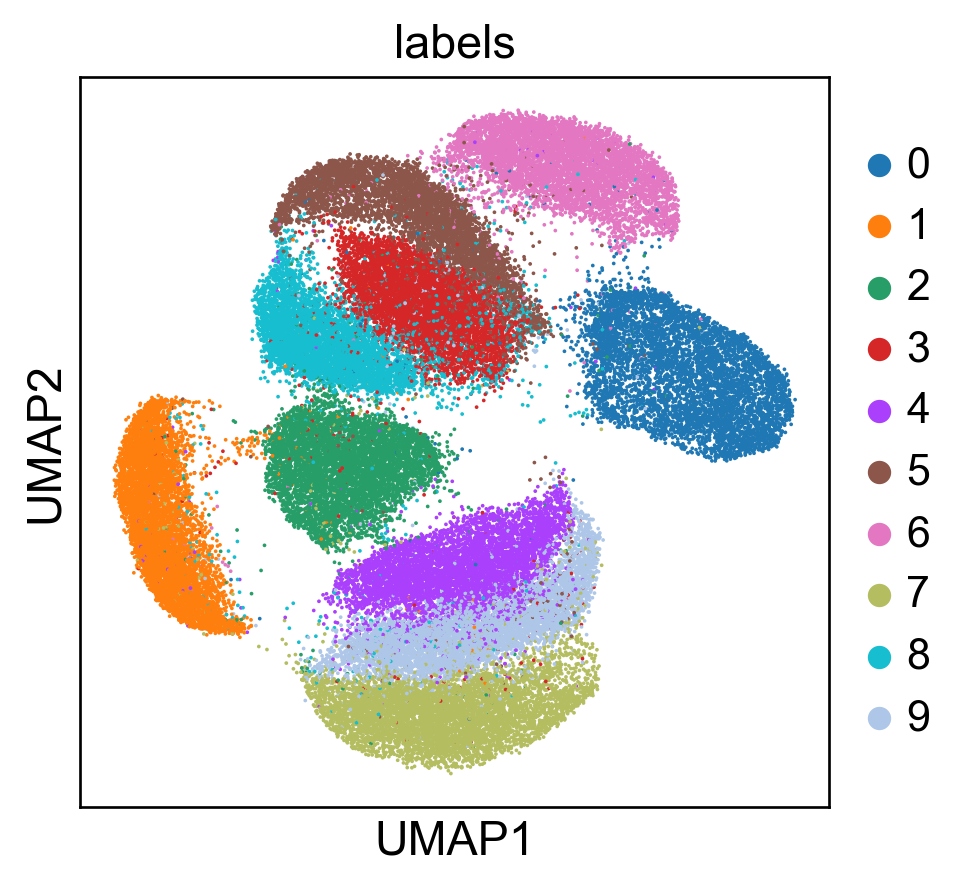

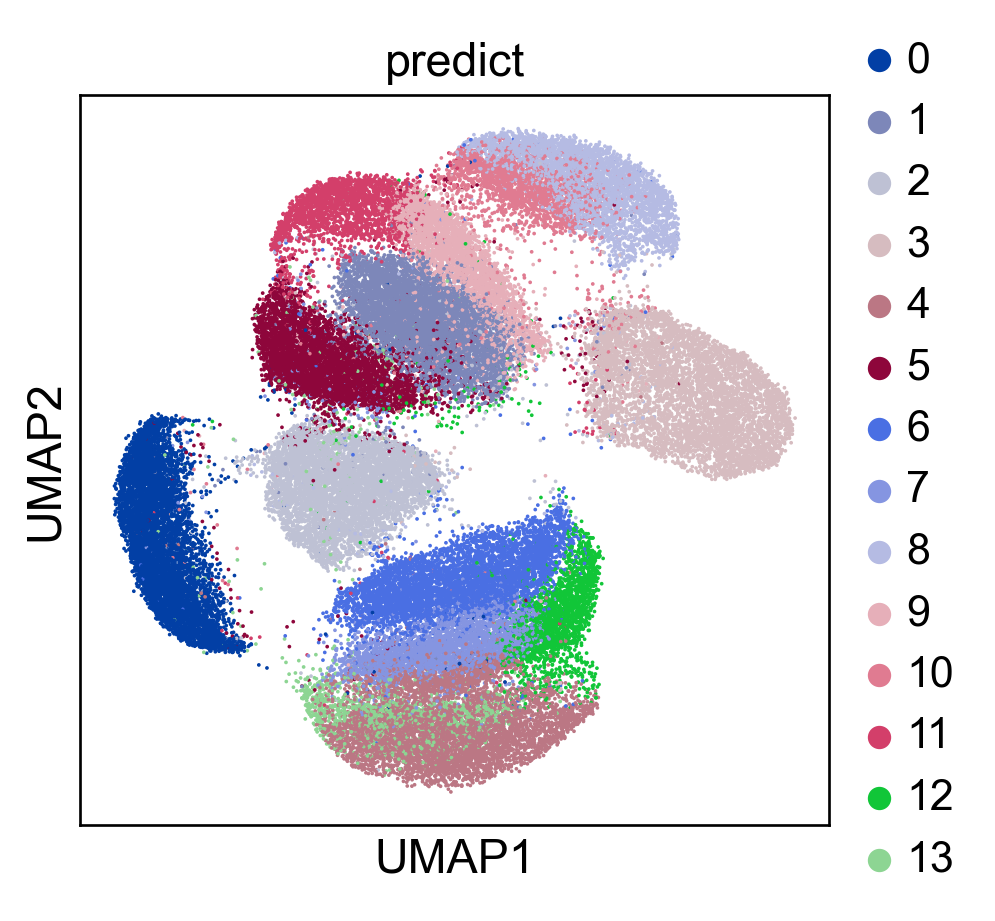

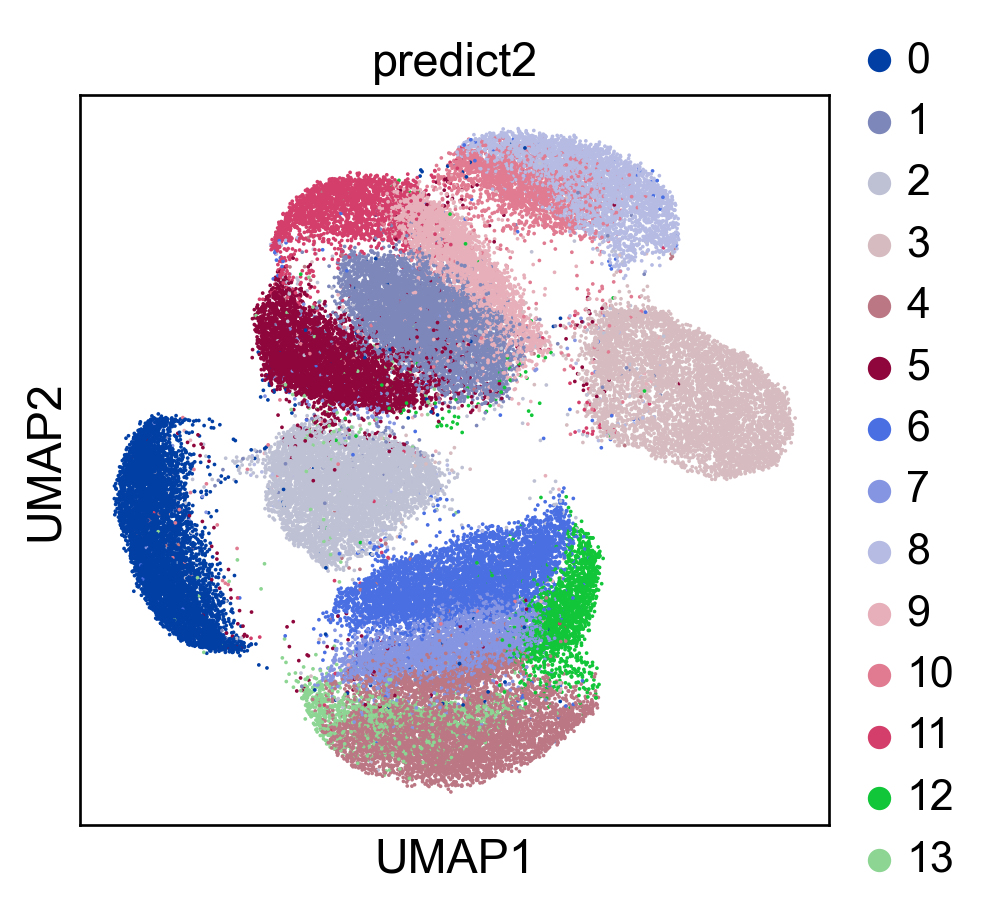

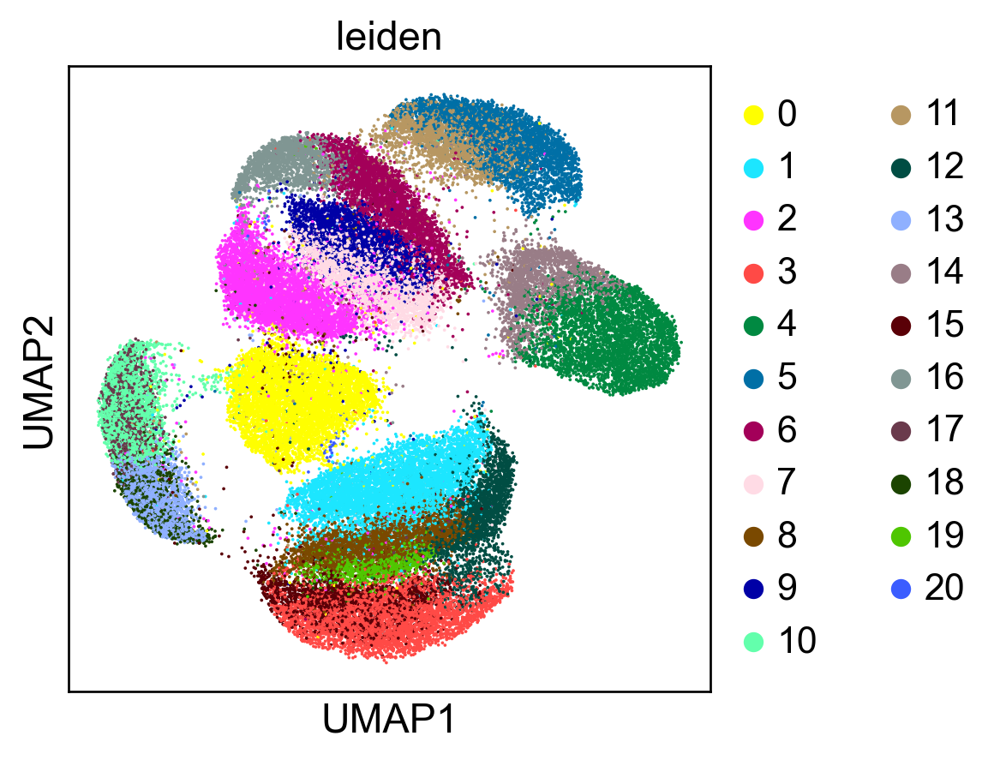

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 12 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:07)


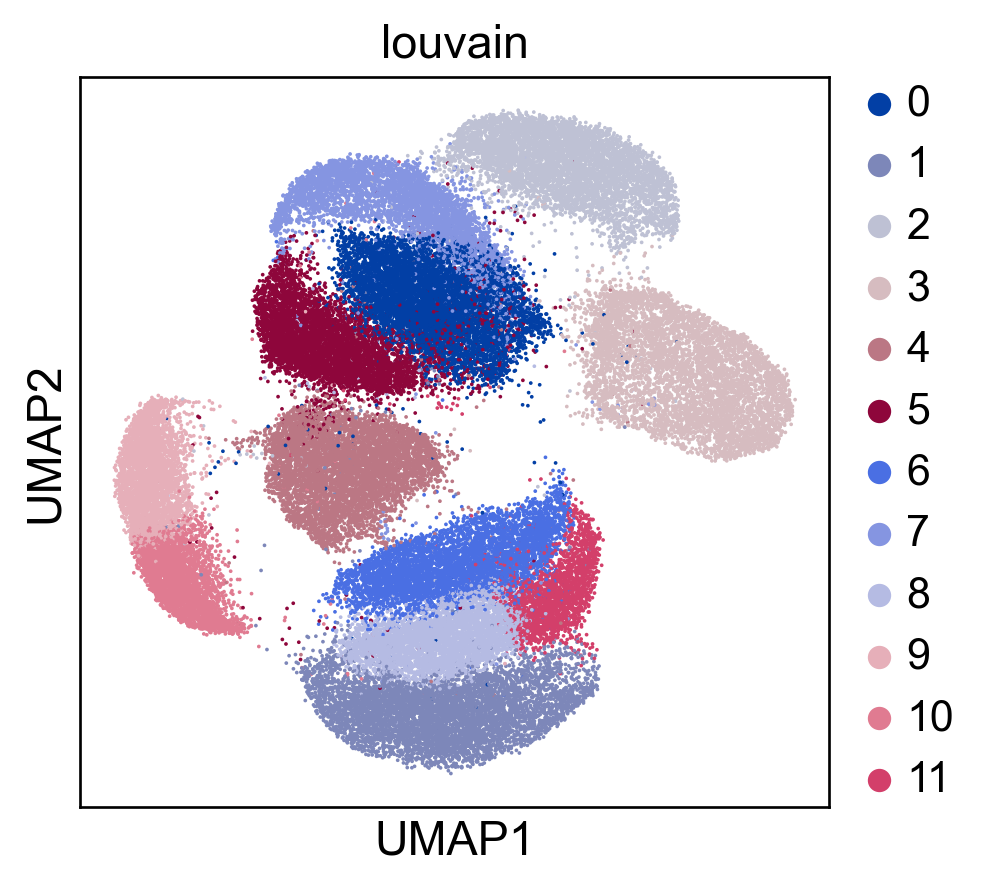

In [70]:
model3.eval()
output = model3(data)
adata.obsm["z"] = output["z"].detach().numpy()
adata.obs["predict"] = output["q_y"].detach().argmax(-1).numpy().astype(str)
adata.obs["predict2"] = output["d_logits"].detach().argmax(-1).numpy().astype(str)
sc.pp.neighbors(adata, use_rep="z", n_neighbors=10,)
sc.tl.umap(adata,)

sc.pl.umap(adata, color=["labels"], size=5)
sc.pl.umap(adata, color=["predict", ],size=5)
sc.pl.umap(adata, color=["predict2", ],size=5)

sc.pl.umap(adata, color=["leiden", ],size=5)

sc.tl.louvain(adata, copy=False)

sc.pl.umap(adata, color=["louvain", ],size=5)
del output

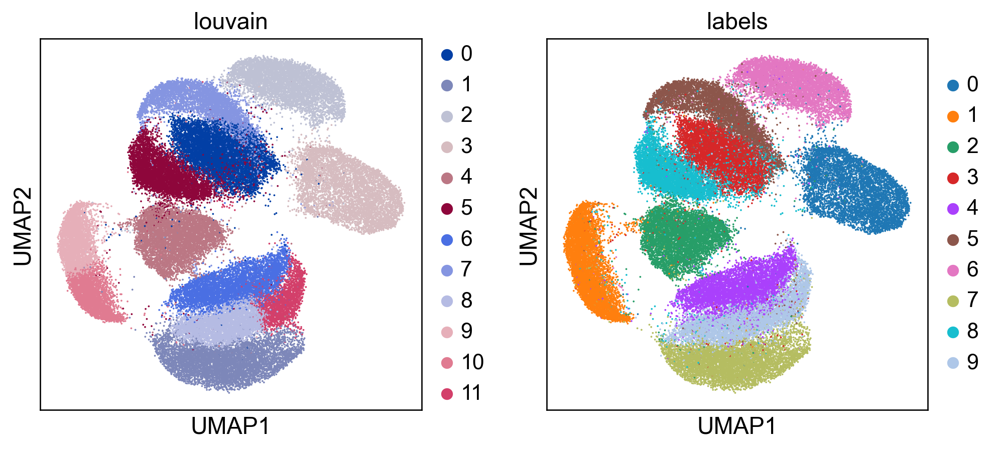

In [71]:
sc.pl.umap(adata, color=["louvain", "labels",],size=5)


In [2]:
# sanity check
adata = sc.read("./data/GTEx_8_tissues_snRNAseq_atlas_071421.public_obs.h5ad",)


data = torch.FloatTensor(adata.X.toarray())
enc_ct.fit(adata.obs["Granular cell type"])
labels = torch.IntTensor(
        enc_ct.transform(adata.obs["Granular cell type"]))
labels = F.one_hot(labels.long(), num_classes=enc_ct.classes_.size).float()
dataset = ut.SynteticDataSet(data, labels)
data_loader = torch.utils.data.DataLoader(
        dataset=dataset,
        batch_size=256,
        shuffle=True,
        )

#dataset = ut.SynteticDataSet(data, labels)
labeled_loader = torch.utils.data.DataLoader(
        dataset=ut.SynteticDataSet(data[:1600], labels[:1600]),
        batch_size=256,
        shuffle=True,
        )
unlabeled_loader = torch.utils.data.DataLoader(
        dataset=ut.SynteticDataSet(data[1600:-1500], labels[1600:-1500]),
        batch_size=256,
        shuffle=True,
        )
test_loader = torch.utils.data.DataLoader(
        dataset=ut.SynteticDataSet(data[-1500:], labels[-1500:]),
        batch_size=256,
        shuffle=True,
        )


In [4]:
model = M7.VAE_Dirichlet_Type705(nx=adata.n_vars, nh=1024,
        nz=64, nw=15, nclasses=enc_ct.classes_.size,)
model.apply(init_weights)

M8.basicTrain(model, unlabeled_loader, test_loader, num_epochs=20,
        wt=0, lr=1e-3, report_interval=4)


training phase
rec: 19155.197265625
loss_p: 1.1984829902648926
loss_z: 40.456939697265625
loss_w: 7.3237457275390625
loss_l: 0.11169782280921936
loss_l_alt: 0.4298747777938843
loss_y: -0.09121392667293549
loss_d: 2225.005859375
loss_y_alt: 1.9853107929229736
total_loss: 21429.96875
num_clusters: 0

training phase
rec: 2381.11376953125
loss_p: 16.816377639770508
loss_z: 15.362161636352539
loss_w: 4.7476091384887695
loss_l: 1.247816562652588
loss_l_alt: 4.272966384887695
loss_y: -0.9883736968040466
loss_d: 0.0
loss_y_alt: 16.732236862182617
total_loss: 2417.95556640625
num_clusters: 29

training phase
rec: 1973.07763671875
loss_p: 17.1812686920166
loss_z: 15.216053009033203
loss_w: 4.733652114868164
loss_l: 1.3274255990982056
loss_l_alt: 4.289593696594238
loss_y: -0.9949333667755127
loss_d: 0.0
loss_y_alt: 16.660688400268555
total_loss: 2009.68798828125
num_clusters: 31

training phase
rec: 2076.799072265625
loss_p: 17.05484390258789
loss_z: 16.78044891357422
loss_w: 5.119940280914307
lo

In [5]:
model.eval()
output = model(data)
adata.obsm["z_gmmdvae"] = output["z"].detach().numpy()
adata.obs["predict_gmmdvae"] = output["q_y"].detach().argmax(-1).numpy().astype(str)


In [6]:
sc.pp.neighbors(adata, use_rep="z_gmmdvae", n_neighbors=10,)
sc.tl.umap(adata,)


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:27)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:25)


/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predict_gmmdvae' as categorical


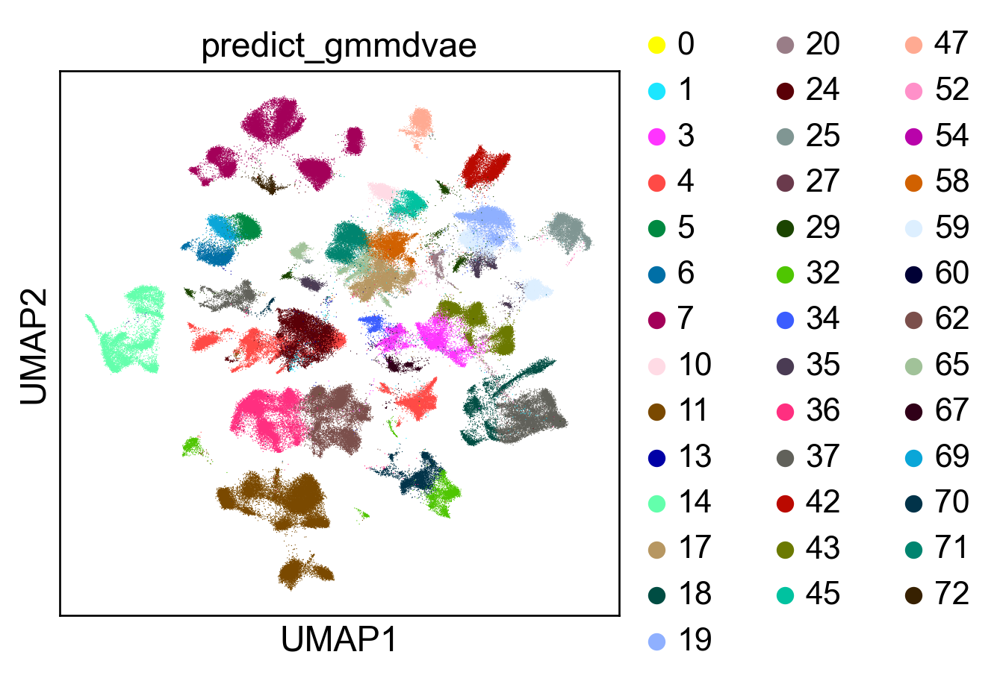

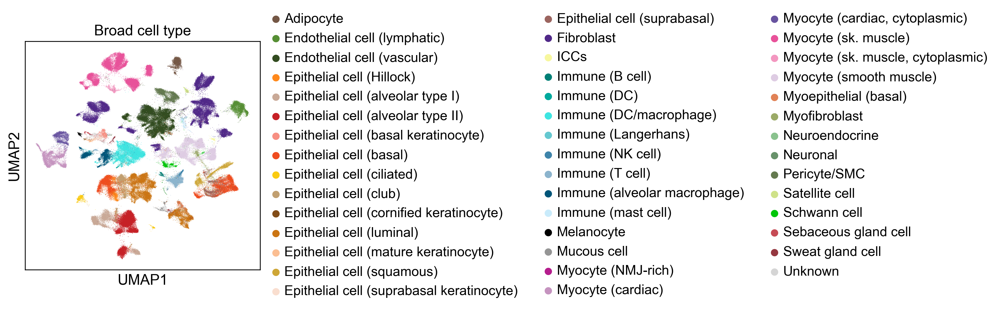

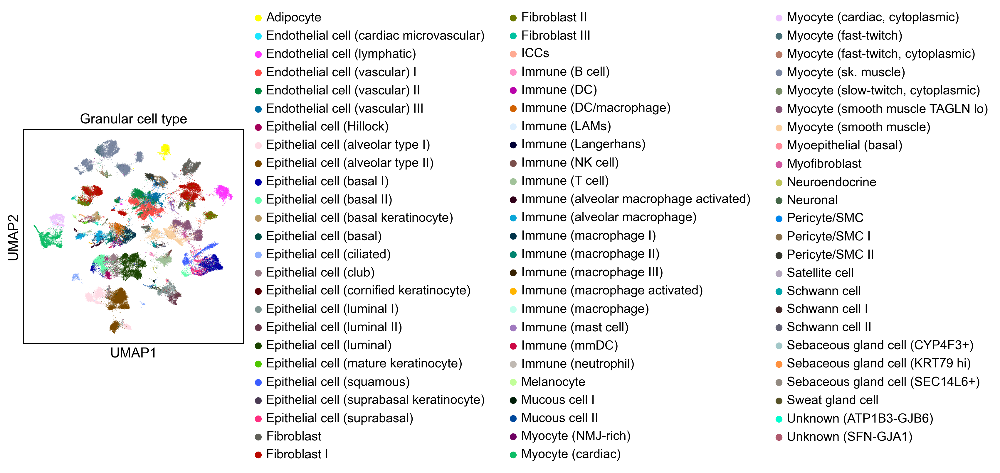

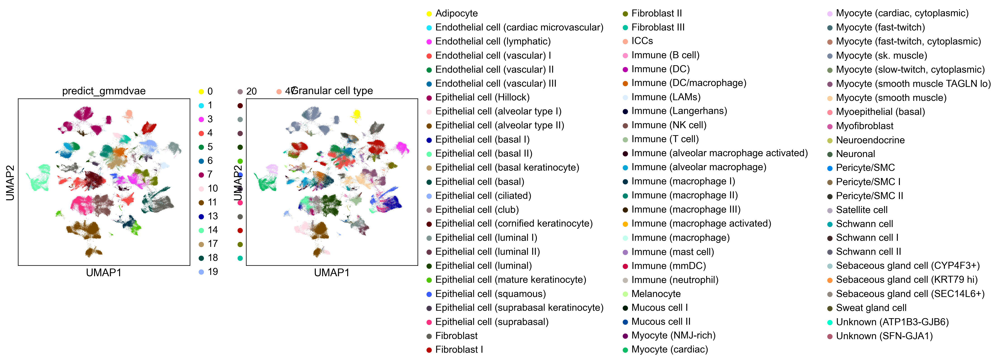

In [7]:
sc.pl.umap(adata, color=["predict_gmmdvae",], )
sc.pl.umap(adata, color=["Broad cell type",], )
sc.pl.umap(adata, color=["Granular cell type",], )

sc.pl.umap(adata, color=["predict_gmmdvae", "Granular cell type",], )


In [8]:
del output


In [12]:
#model = M7.VAE_Dirichlet_Type705(nx=adata.n_vars, nh=1024,
#        nz=64, nw=15, nclasses=enc_ct.classes_.size,)
#model.apply(init_weights)
#
model3 = M8.VAE_Dirichlet_Type807(
        nx=adata.n_vars, nh=1024,
        nz=64, nw=40,
        dirscale=1e0,
        concentration=5e-1,
        nclasses=enc_ct.classes_.size
        )
model3.apply(init_weights)


M8.basicTrain(model, unlabeled_loader, test_loader, num_epochs=25,
        wt=0, lr=1e-3, report_interval=4)


training phase
rec: 1393.3408203125
loss_p: 17.019916534423828
loss_z: 15.347654342651367
loss_w: 4.411075592041016
loss_l: 1.1259467601776123
loss_l_alt: 4.26661491394043
loss_y: -0.9851160645484924
loss_d: 0.0
loss_y_alt: 16.33906364440918
total_loss: 1429.438720703125
num_clusters: 32

training phase
rec: 1728.5662841796875
loss_p: 16.933700561523438
loss_z: 15.821654319763184
loss_w: 4.440189361572266
loss_l: 0.9830199480056763
loss_l_alt: 4.262676239013672
loss_y: -0.9826360940933228
loss_d: 0.0
loss_y_alt: 16.528438568115234
total_loss: 1765.3565673828125
num_clusters: 41

training phase
rec: 1840.7945556640625
loss_p: 16.98958969116211
loss_z: 15.909639358520508
loss_w: 4.250753402709961
loss_l: 0.8129029273986816
loss_l_alt: 4.242391586303711
loss_y: -0.9752213358879089
loss_d: 0.0
loss_y_alt: 16.66677474975586
total_loss: 1877.6217041015625
num_clusters: 50

training phase
rec: 1861.106201171875
loss_p: 16.924034118652344
loss_z: 17.006784439086914
loss_w: 4.227727890014648
lo

In [13]:
model.eval()
output = model(data)
adata.obsm["z_gmmdvae"] = output["z"].detach().numpy()
adata.obs["predict_gmmdvae"] = output["q_y"].detach().argmax(-1).numpy().astype(str)
del output

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:26)


/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predict_gmmdvae' as categorical


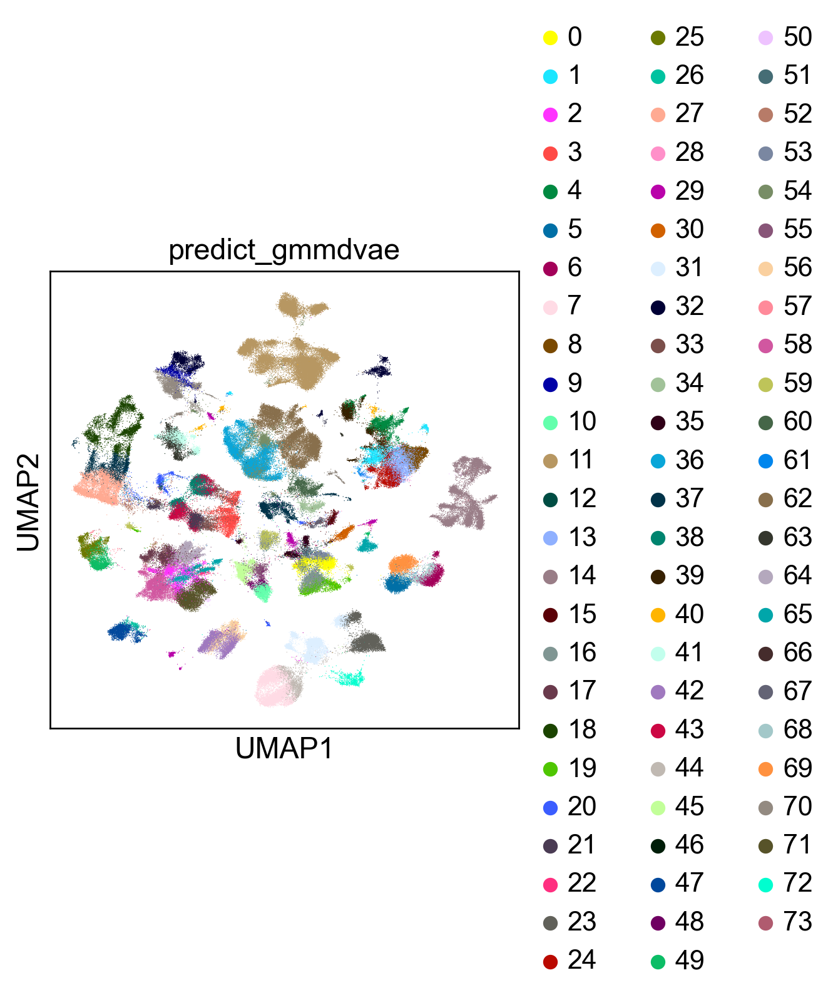

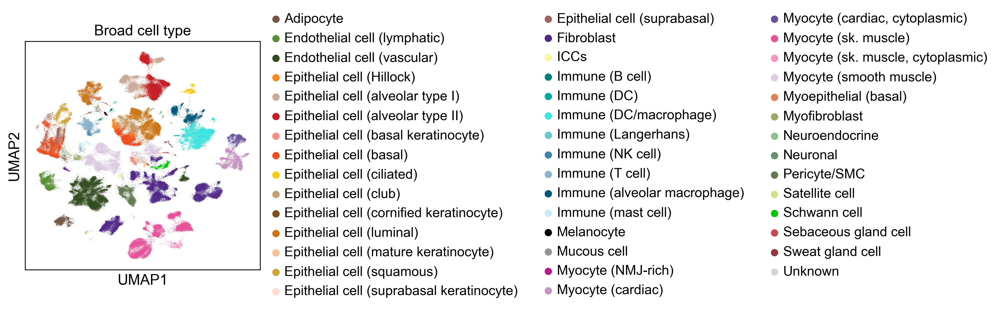

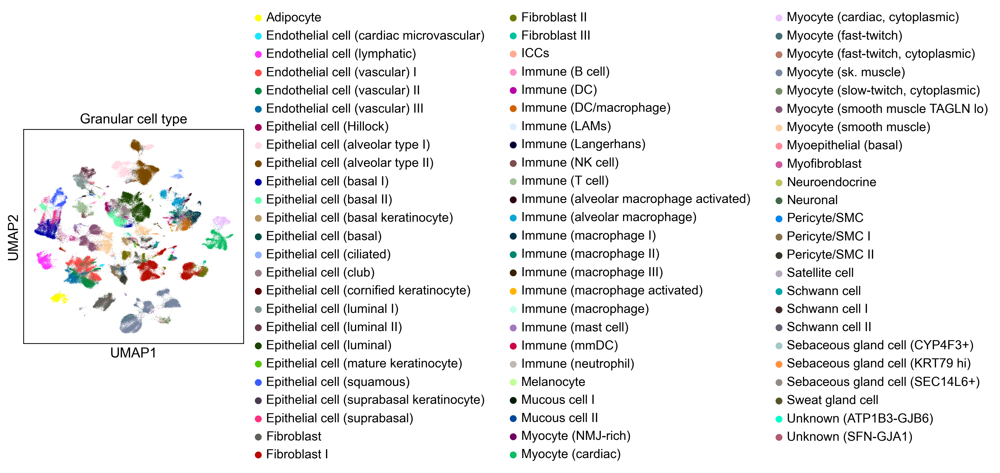

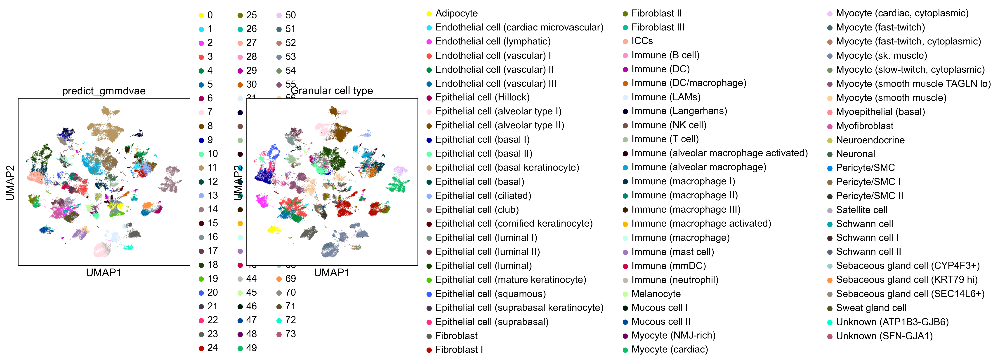

In [14]:
sc.pp.neighbors(adata, use_rep="z_gmmdvae", n_neighbors=10,)
sc.tl.umap(adata,)
sc.pl.umap(adata, color=["predict_gmmdvae",], )
sc.pl.umap(adata, color=["Broad cell type",], )
sc.pl.umap(adata, color=["Granular cell type",], )

sc.pl.umap(adata, color=["predict_gmmdvae", "Granular cell type",], )


In [15]:
import gmmvae09 as M9

True


In [20]:
#model = M8.VAE_Dirichlet_Type807(
#        nx=adata.n_vars, nh=1024,
#        nz=64, nw=40,
#        dirscale=1e0,
#        concentration=5e-1,
#        nclasses=enc_ct.classes_.size
#        )
#model.apply(init_weights)


#M8.basicTrain(model3, unlabeled_loader, test_loader, num_epochs=35,
#        wt=0, lr=1e-3, report_interval=4)
#
M8.basicTrain(model3, unlabeled_loader, test_loader, num_epochs=5,
        wt=0, lr=1e-3, report_interval=4)

training phase
rec: 1995.1114501953125
loss_z: 16.35712242126465
loss_w: 3.037024736404419
loss_l: 0.558577299118042
loss_l_alt: 4.27786922454834
loss_y: -0.9898242950439453
loss_d: 0.7188774347305298
loss_y_alt: 3.6153669357299805
loss_y_alt2: 0
total_loss: 2018.83984375
num_clusters: 56

training phase
rec: 1904.0885009765625
loss_z: 16.013675689697266
loss_w: 3.4140639305114746
loss_l: 0.5027139782905579
loss_l_alt: 4.265711784362793
loss_y: -0.9829400777816772
loss_d: 0.7396228313446045
loss_y_alt: 3.7261548042297363
loss_y_alt2: 0
total_loss: 1927.9820556640625
num_clusters: 58

done training


In [21]:
model = model3
model

VAE_Dirichlet_Type807(
  (Px): Sequential(
    (linear1): Linear(in_features=64, out_features=1024, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=1024, out_features=1024, bias=True)
    (dropout2): Dropout(p=0.2, inplace=False)
    (batchnorm2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation2): LeakyReLU(negative_slope=0.01)
    (output_layer): Linear(in_features=1024, out_features=17695, bias=True)
  )
  (Pz): Sequential(
    (linear1): Linear(in_features=40, out_features=1024, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=1024, out_features=1024, bias

In [22]:
model.eval()
output = model(data)
adata.obsm["z_gmmdvae"] = output["z"].detach().numpy()
adata.obs["predict_gmmdvae"] = output["q_y"].detach().argmax(-1).numpy().astype(str)
del output

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:25)


/home/ykolb/miniconda3/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predict_gmmdvae' as categorical


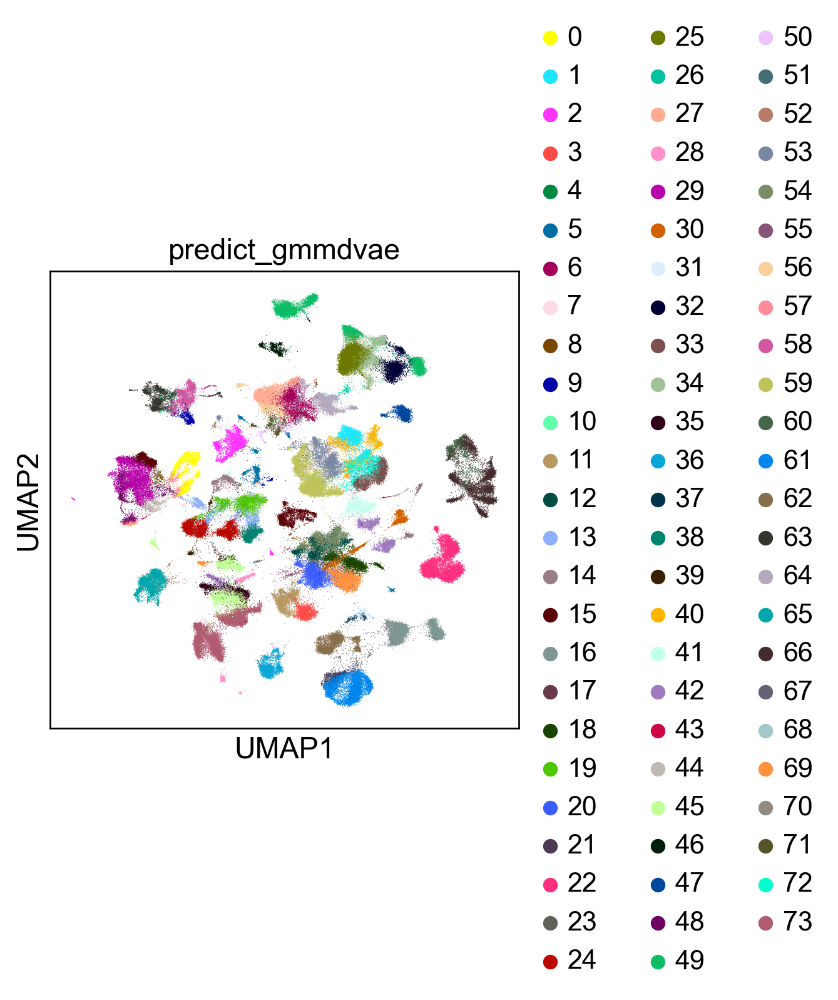

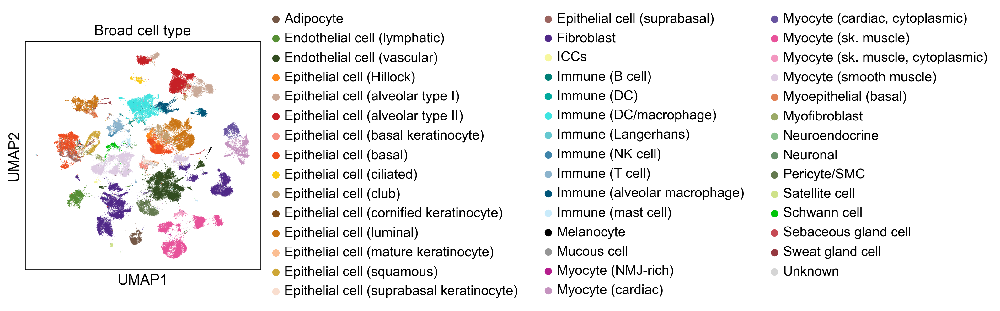

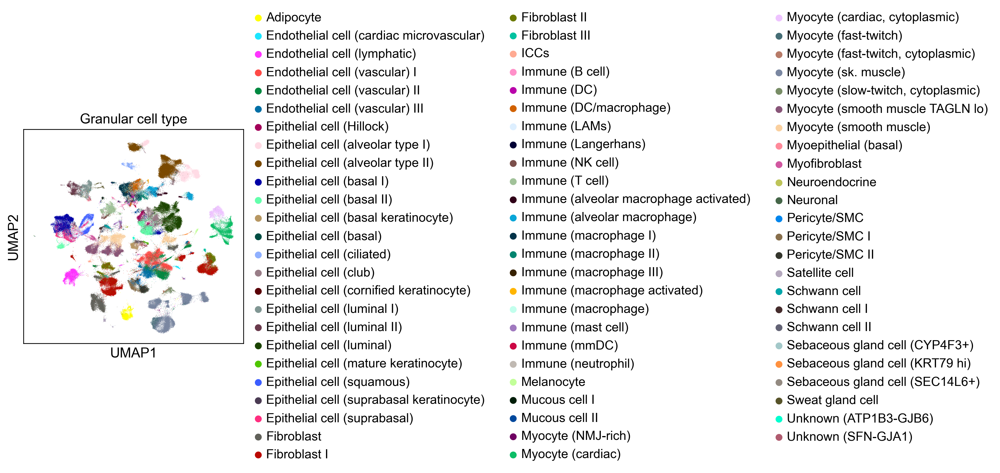

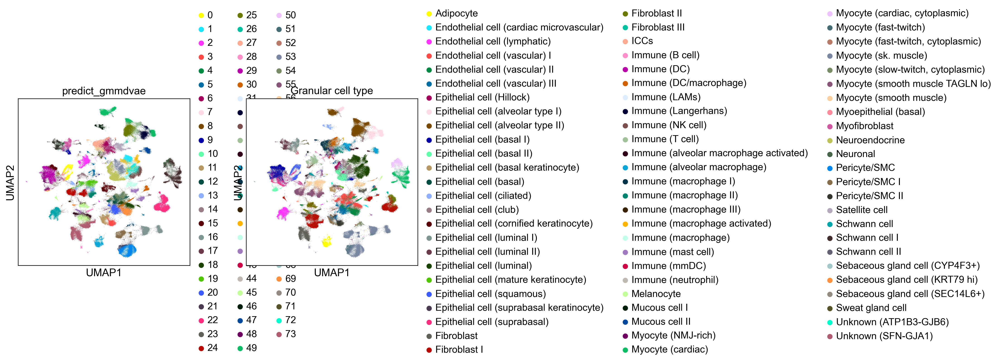

In [23]:
sc.pp.neighbors(adata, use_rep="z_gmmdvae", n_neighbors=10,)
sc.tl.umap(adata,)
sc.pl.umap(adata, color=["predict_gmmdvae",], )
sc.pl.umap(adata, color=["Broad cell type",], )
sc.pl.umap(adata, color=["Granular cell type",], )
sc.pl.umap(adata, color=["predict_gmmdvae", "Granular cell type",], )

In [3]:
#model = M8.VAE_Dirichlet_Type807(
#        nx=adata.n_vars, nh=1024,
#        nz=64, nw=40,
#        dirscale=1e0,
#        concentration=5e-1,
#        nclasses=enc_ct.classes_.size
#        )
#model.apply(init_weights)


#M8.basicTrain(model3, unlabeled_loader, test_loader, num_epochs=35,
#        wt=0, lr=1e-3, report_interval=4)
#
model = M9.VAE_Dirichlet_Type912(
        nx=adata.n_vars, nh=1024,
        nz=64, nw=40,
        dirscale=1e0,
        concentration=5e-1,
        nclasses=enc_ct.classes_.size,
        dropout=0.2,
        numhidden=2,
)
model.apply(init_weights)

M8.basicTrain(model, unlabeled_loader, test_loader, num_epochs=35,
        wt=0, lr=1e-3, report_interval=4)


training phase
rec: 19183.62109375
loss_z: 50.927452087402344
loss_w: 22.377899169921875
loss_l: 0.13110984861850739
loss_l_alt: 0.44190365076065063
loss_y: -0.08997750282287598
loss_d: 41.01160430908203
loss_y_alt: 1.8185309171676636
loss_y_alt2: 0
total_loss: 19299.755859375
num_clusters: 0



ValueError: Expected parameter loc (Tensor of shape (256, 40)) of distribution Normal(loc: torch.Size([256, 40]), scale: torch.Size([256, 40])) to satisfy the constraint Real(), but found invalid values:
tensor([[nan, nan, nan,  ..., nan, nan, nan],
        [nan, nan, nan,  ..., nan, nan, nan],
        [nan, nan, nan,  ..., nan, nan, nan],
        ...,
        [nan, nan, nan,  ..., nan, nan, nan],
        [nan, nan, nan,  ..., nan, nan, nan],
        [nan, nan, nan,  ..., nan, nan, nan]], device='cuda:0',
       grad_fn=<SliceBackward0>)

In [4]:
model

VAE_Dirichlet_Type912(
  (Px): Sequential(
    (linear1): Linear(in_features=64, out_features=1024, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=1024, out_features=1024, bias=True)
    (dropout2): Dropout(p=0.2, inplace=False)
    (batchnorm2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation2): LeakyReLU(negative_slope=0.01)
    (output_layer): Linear(in_features=1024, out_features=17695, bias=True)
  )
  (Pz): Sequential(
    (linear1): Linear(in_features=40, out_features=1024, bias=True)
    (dropout1): Dropout(p=0.2, inplace=False)
    (batchnorm1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation1): LeakyReLU(negative_slope=0.01)
    (linear2): Linear(in_features=1024, out_features=1024, bias